In [1]:
import sys
import os
import gzip
import pickle
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np
import matplotlib.pyplot as plt
from datetime import datetime
from tqdm import tqdm

from sae import SparseAutoencoder
from utils import *
from analysis_utils import *

In [2]:
#TODO: create a code that take the trajectory, runs activation collection, run SAE and output features from certain layer
# This should allow us to play wiht trajectory classes to see how features react on them

In [6]:
run_dir = './sae.encoder.outer.residual1_20250308_230626'
model_path = f'{run_dir}/checkpoints/sae_final.pt'
#model_path = f"./best_sae_model.pt"
output_dir = f"{run_dir}/feature_activations"
device = "cpu"
print(f"Using device: {device}")

print(f"Attempting to load model from: {model_path}")
model = SparseAutoencoder(input_dim=256, latent_dim=1280)
model.load_state_dict(torch.load(model_path, map_location=device,weights_only=True))
model.eval()

print("Model loaded successfully")
print(f"Model name: {model.name}")
print(f"Model input dimension: {model.input_dim}")
print(f"Model latent dimension: {model.latent_dim}")

Using device: cpu
Attempting to load model from: ./sae.encoder.outer.residual1_20250308_230626/checkpoints/sae_final.pt
Model loaded successfully
Model name: None
Model input dimension: 256
Model latent dimension: 1280


In [7]:
data_path = '../data/activations/random_solutions_activations_10k.pkl.gz'
print(f"Attempting to load data from: {data_path}")
with gzip.open(data_path, 'rb') as file:
    collected_act = pickle.loads(file.read())
print(f"Data loaded successfully. Found {len(collected_act)} samples.")

Attempting to load data from: ../data/activations/random_solutions_activations_10k.pkl.gz
Data loaded successfully. Found 9998 samples.


In [8]:
samples = extract_activations_and_trajectories(model, collected_act)

Extracting activations: 9998it [00:14, 691.74it/s]

Extracted data from 9998 trajectories


In [9]:
all_mean_activations = np.array([sample['mean_activation'] for idx,sample in enumerate(samples)])
all_max_activations = np.array([sample['max_activation'] for idx,sample in enumerate(samples)])
top_features = np.argsort(-np.max(all_max_activations, axis=0))[:100]

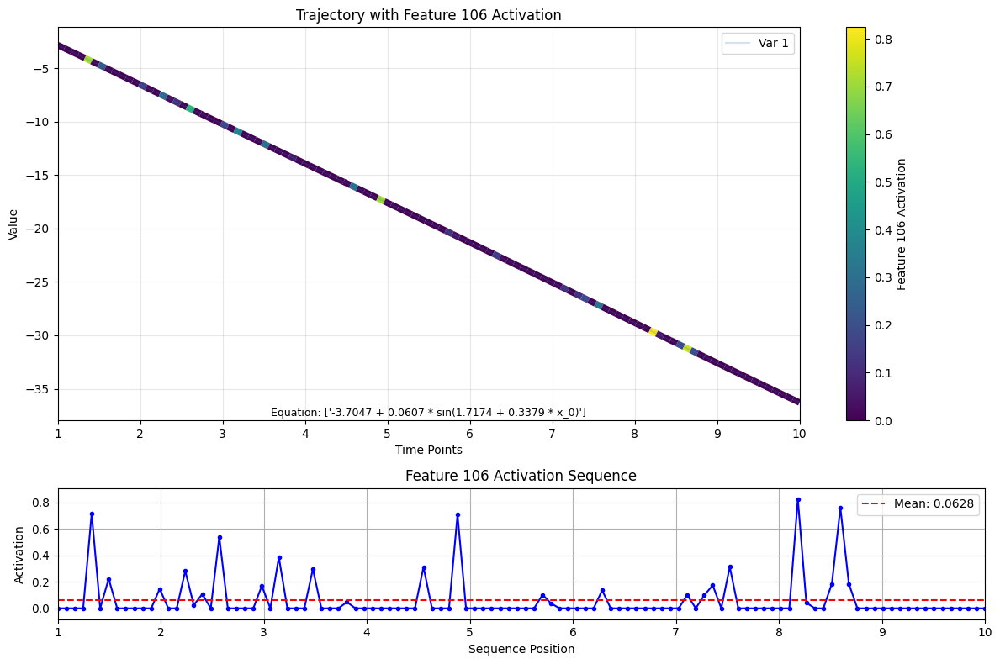

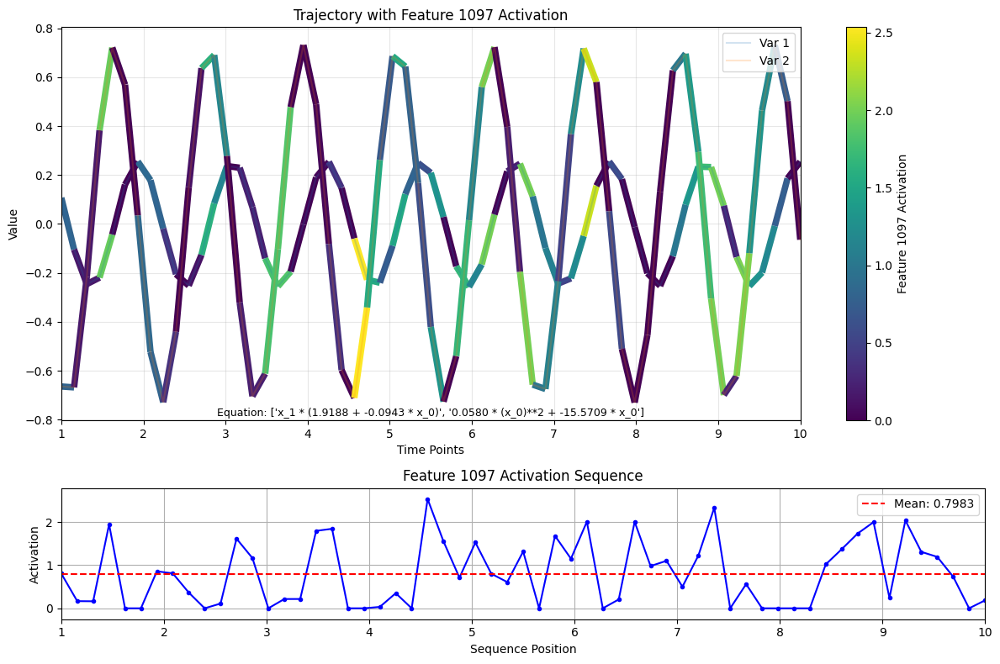

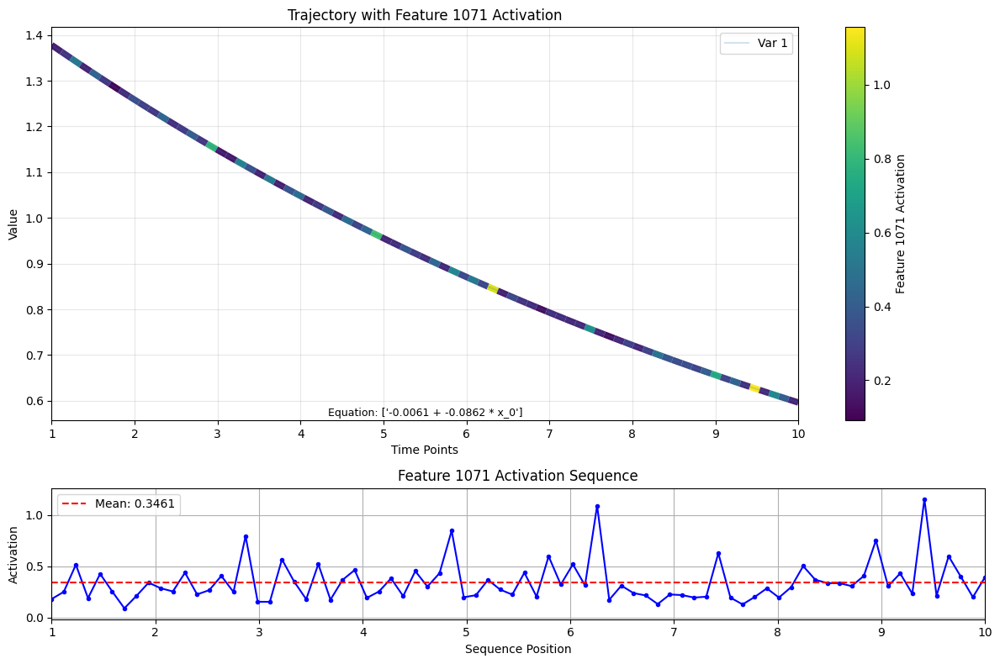

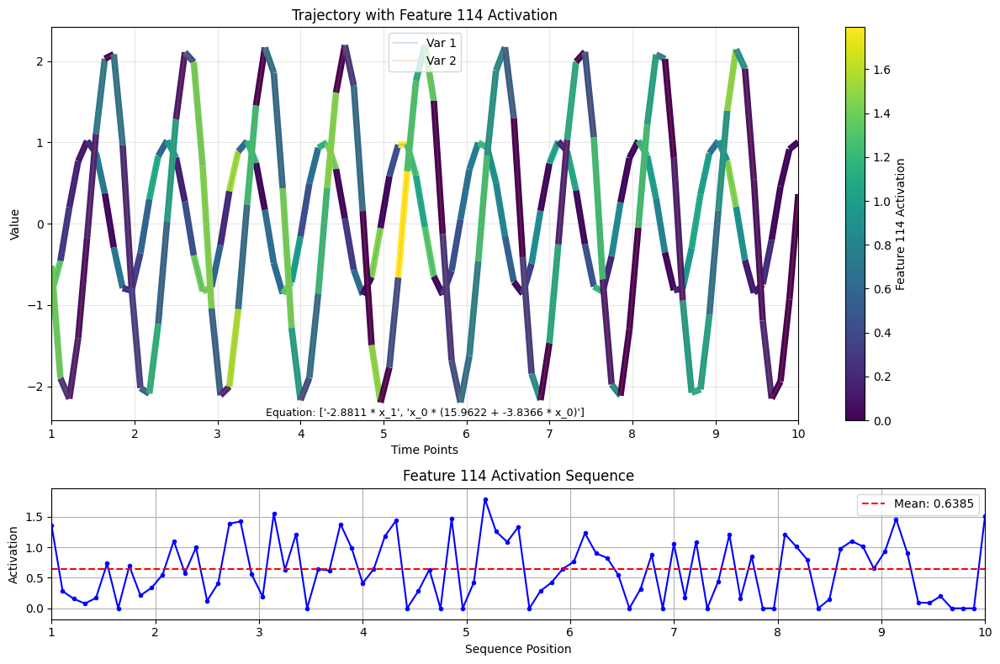

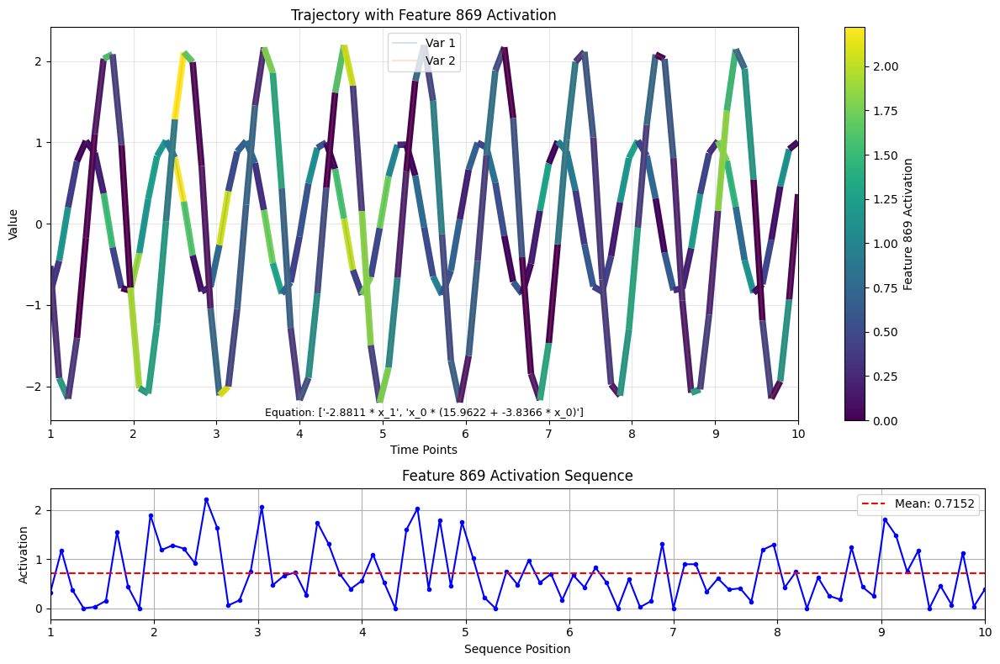

...

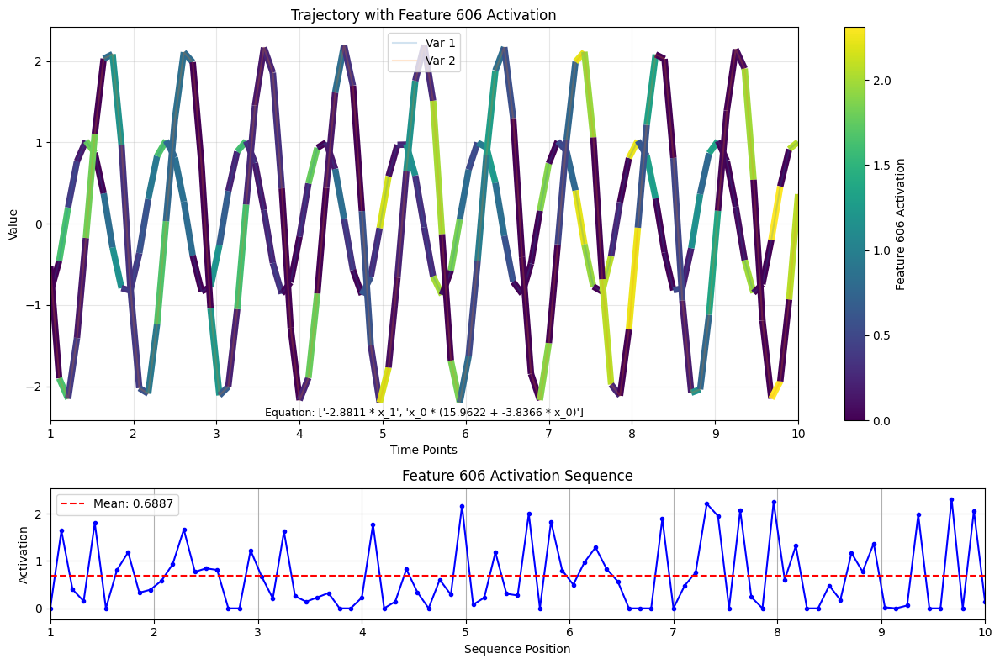

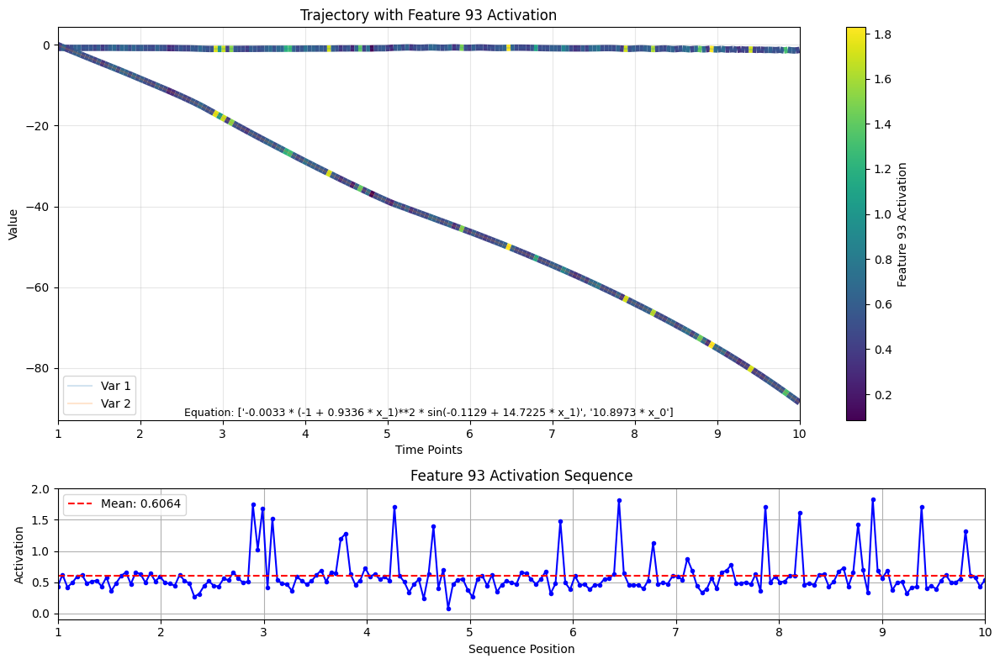

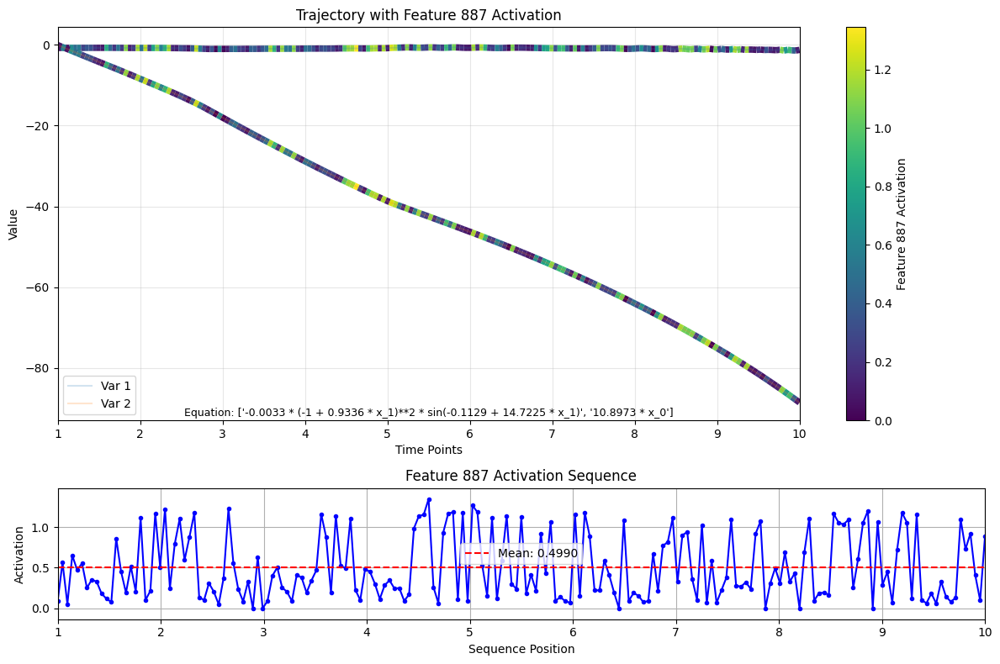

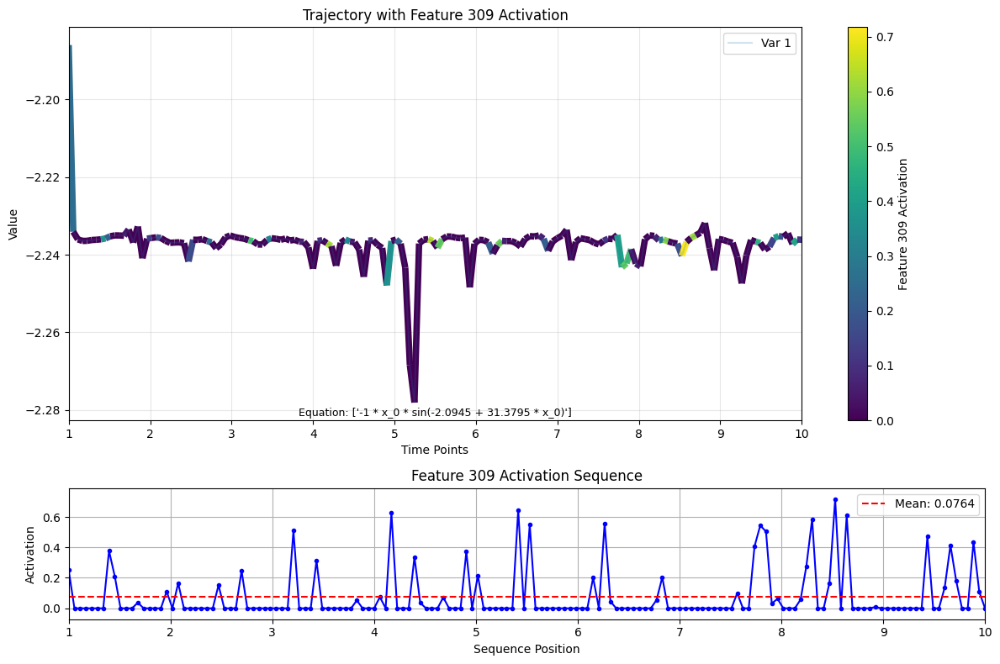

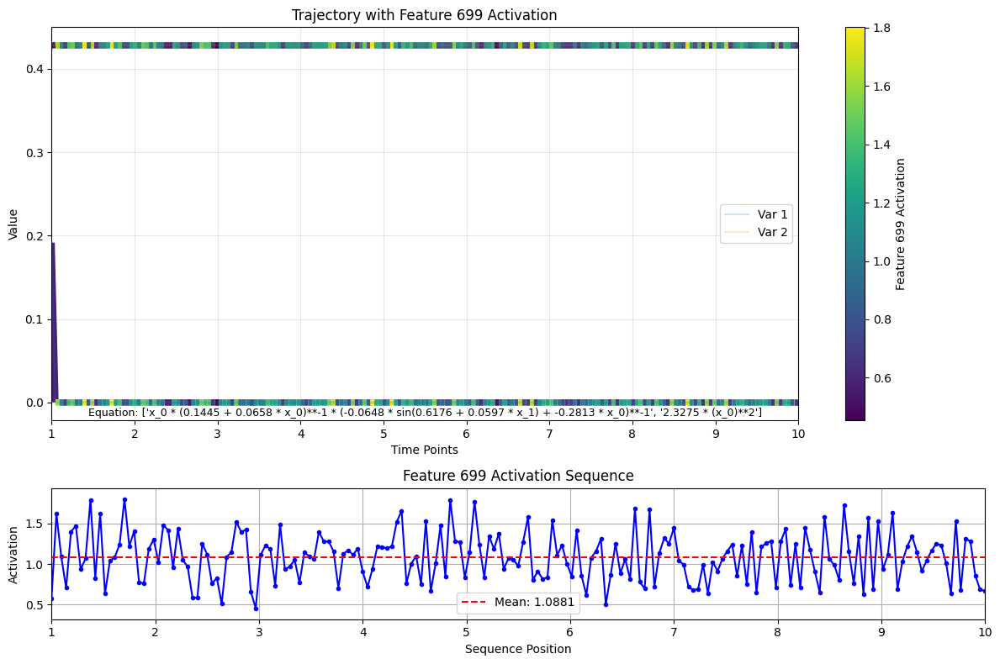

In [10]:
for feature_idx in top_features:
    feature_mean_activations = all_mean_activations[feature_idx]
    top_idx = np.argmax(feature_mean_activations)

    top_sample = samples[top_idx]
    trajectory = top_sample['trajectory']
    activations = top_sample['activations']
    time_points = top_sample['time_points']
    equation = top_sample['equation']
    
    title = f"Feature {feature_idx} - Top Activating Trajectory - Mean: {feature_mean_activations[top_idx]:.4f}"
    
    save_path = None
    if output_dir:
        os.makedirs(output_dir, exist_ok=True)
        save_path = os.path.join(output_dir, f"feature_{feature_idx}_activations.png")
    
    fig, _ = plot_activation_along_trajectory(
        trajectory, activations, feature_idx,
        time_points, equation,linewidth=5.5, save_path=save_path
    )
    plt.show()